# Assignment 1 
1. Abhijeet Bhatta (SR No.: 25169)
2. Ankush Kumar (SR No.: 24033)
3. Chanyanka Kakati (SR No.: 27228)
4. Suman Dafadar (SR No.: 24139)


# Event-Driven Elliptic Stadium Billiard

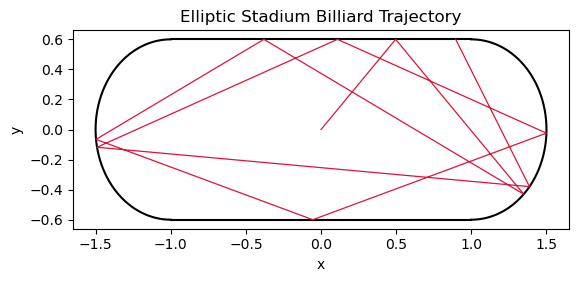

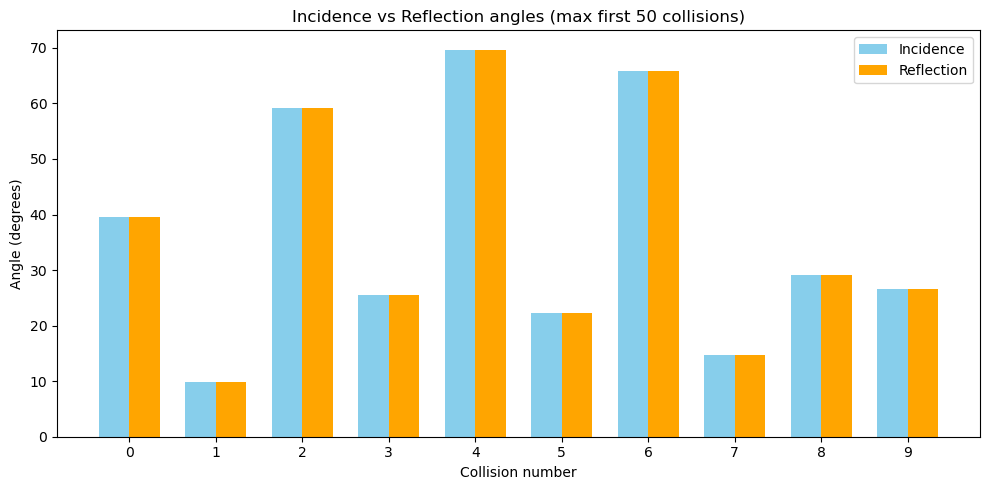

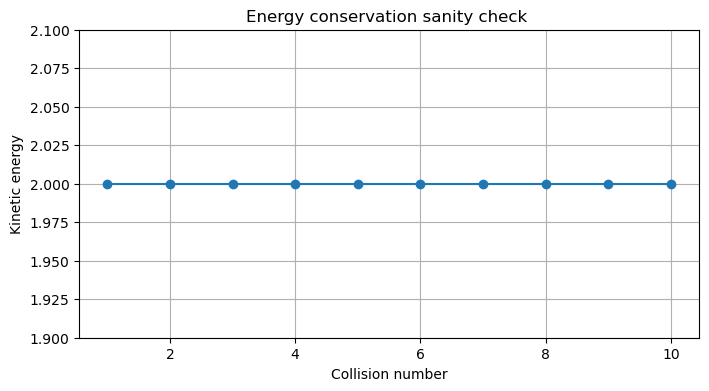

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# -------------------- Stadium parameters --------------------
a  = 1.0   # half-length of straight part
b  = 0.6   # half-height
rx = 0.5   # ellipse semi-axis x
ry = b     # ellipse semi-axis y
EPS = 1e-12

# -------------------- Geometry helpers --------------------
def reflect(v, n):
    n_hat = n / np.linalg.norm(n)
    return v - 2.0 * np.dot(v, n_hat) * n_hat

def ellipse_normal(x, y, xc, yc, rx, ry):
    n = np.array([(x - xc)/(rx**2), (y - yc)/(ry**2)], dtype=float)
    n /= np.linalg.norm(n)
    return n

def solve_quadratic(A, B, C):
    if abs(A) < 1e-14:
        if abs(B) < 1e-14:
            return []
        return [-C/B]
    disc = B*B - 4*A*C
    if disc < 0:
        return []
    sqrt_disc = np.sqrt(max(0.0, disc))
    return [(-B - sqrt_disc)/(2*A), (-B + sqrt_disc)/(2*A)]

# -------------------- Next collision --------------------
def next_collision(r, v, a, b, rx, ry):
    x, y = float(r[0]), float(r[1])
    vx, vy = float(v[0]), float(v[1])
    candidates = []

    # Horizontal walls
    if abs(vy) > EPS:
        # top
        t = (b - y)/vy
        if t > EPS:
            X = x + vx*t
            if abs(X) <= a + EPS:
                candidates.append(("top", t, np.array([X,b]), np.array([0.0,1.0])))
        # bottom
        t = (-b - y)/vy
        if t > EPS:
            X = x + vx*t
            if abs(X) <= a + EPS:
                candidates.append(("bottom", t, np.array([X,-b]), np.array([0.0,-1.0])))

    # Right ellipse
    dx = x - a
    A = (vx*vx)/(rx*rx) + (vy*vy)/(ry*ry)
    B = 2*(dx*vx/(rx*rx) + y*vy/(ry*ry))
    C = dx*dx/(rx*rx) + y*y/(ry*ry) - 1.0
    for t in solve_quadratic(A,B,C):
        if t > EPS:
            X = x + vx*t
            Y = y + vy*t
            if X >= a - EPS:
                n = ellipse_normal(X,Y,a,0,rx,ry)
                candidates.append(("cap_right", t, np.array([X,Y]), n))

    # Left ellipse
    dx = x + a
    A = (vx*vx)/(rx*rx) + (vy*vy)/(ry*ry)
    B = 2*(dx*vx/(rx*rx) + y*vy/(ry*ry))
    C = dx*dx/(rx*rx) + y*y/(ry*ry) - 1.0
    for t in solve_quadratic(A,B,C):
        if t > EPS:
            X = x + vx*t
            Y = y + vy*t
            if X <= -a + EPS:
                n = ellipse_normal(X,Y,-a,0,rx,ry)
                candidates.append(("cap_left", t, np.array([X,Y]), n))

    if not candidates:
        raise RuntimeError(f"No collision found from r={r}, v={v}")

    # pick earliest collision
    which, t_hit, r_hit, n_vec = min(candidates, key=lambda item: item[1])
    v_after = reflect(v, n_vec)
    return t_hit, r_hit, v, v_after, n_vec, which

# -------------------- Simulation --------------------
def simulate(r0, v0, n_collisions, a, b, rx, ry):
    r = np.array(r0, dtype=float)
    v = np.array(v0, dtype=float)
    speed = np.linalg.norm(v)
    if speed < EPS:
        raise ValueError("Initial velocity is zero.")
   # v = v / speed

    traj = [r.copy()]
    theta_inc_list = []
    theta_ref_list = []
    energy_list = []

    for _ in range(n_collisions):
        t, r, v_before, v_after, n_vec, which = next_collision(r, v, a, b, rx, ry)
        traj.append(r.copy())

        # flip normal outward
        if np.dot(v_before, n_vec) > 0:
            n_vec = -n_vec

        # angles in degrees
        epsilon = 1e-14
        theta_inc = np.arccos(np.clip(-np.dot(v_before, n_vec)/np.linalg.norm(v_before), -1+epsilon, 1-epsilon))
        theta_ref = np.arccos(np.clip(np.dot(v_after, n_vec)/np.linalg.norm(v_after), -1+epsilon, 1-epsilon))
        theta_inc_list.append(np.degrees(theta_inc))
        theta_ref_list.append(np.degrees(theta_ref))

        # kinetic energy (m=1)
        energy_list.append(0.5 * np.dot(v_after, v_after))

        # update velocity for next step
        v = v_after

    return np.array(traj), theta_inc_list, theta_ref_list, energy_list

# -------------------- Run simulation --------------------




################################### INPUT PARAMETERS ###############################
r0 = np.array([0.0,0.0])
angle = 0.28*np.pi
speed  = 2
v0 = speed*np.array([np.cos(angle), np.sin(angle)])
n_collisions = 10
#####################################################################################



traj, theta_inc_list, theta_ref_list, energy_list = simulate(r0, v0, n_collisions, a, b, rx, ry)

# -------------------- Plot stadium and trajectory --------------------
fig, ax = plt.subplots(figsize=(6.4,3.2))
ax.plot([-a,  a], [ b,  b], 'k-', lw=1.5)
ax.plot([-a,  a], [-b, -b], 'k-', lw=1.5)
theta = np.linspace(-np.pi/2, np.pi/2, 500)
ax.plot(a + rx*np.cos(theta), ry*np.sin(theta), 'k-', lw=1.5)
ax.plot(-a - rx*np.cos(theta), ry*np.sin(theta), 'k-', lw=1.5)
ax.plot(traj[:,0], traj[:,1], color="crimson", lw=0.9)
ax.set_aspect('equal','box'); ax.set_xlabel("x"); ax.set_ylabel("y")
ax.set_title(f"Elliptic Stadium Billiard Trajectory")
plt.show()

# -------------------- Grouped bar chart of angles --------------------
collision_indices = np.arange(n_collisions)
width = 0.35
plt.figure(figsize=(10,5))
theta_inc_list =theta_inc_list[:50]
theta_ref_list =theta_ref_list[:50]
plt.bar(collision_indices - width/2, theta_inc_list, width=width, label="Incidence", color='skyblue')
plt.bar(collision_indices + width/2, theta_ref_list, width=width, label="Reflection", color='orange')
plt.xlabel("Collision number")
plt.ylabel("Angle (degrees)")
plt.title("Incidence vs Reflection angles (max first 50 collisions)")
plt.xticks(collision_indices)
plt.legend()
plt.tight_layout()
plt.show()

# -------------------- Energy conservation check --------------------
plt.figure(figsize=(8,4))
plt.plot(np.arange(1, n_collisions+1), energy_list, 'o-')
plt.xlabel("Collision number")
plt.ylabel("Kinetic energy")
plt.title("Energy conservation sanity check ")
plt.grid(True)

# Fixed linear scale, no autoscaling
plt.yscale('linear')
plt.ticklabel_format(style='plain', axis='y')
margin = 0.05 * max(energy_list)  # 5% margin
plt.ylim(min(energy_list)-margin, max(energy_list)+margin)

plt.show()


# Classical Trajectories for 2 particles and the emergence of chaos

Simulating two trajectories for 100 bounces...
  - Trajectory 1 starts at angle: 0.8796459 radians
  - Trajectory 2 starts at angle: 0.8796559 radians
  - The difference is a tiny 1.0e-05 radians.
Simulations complete. Plotting results...


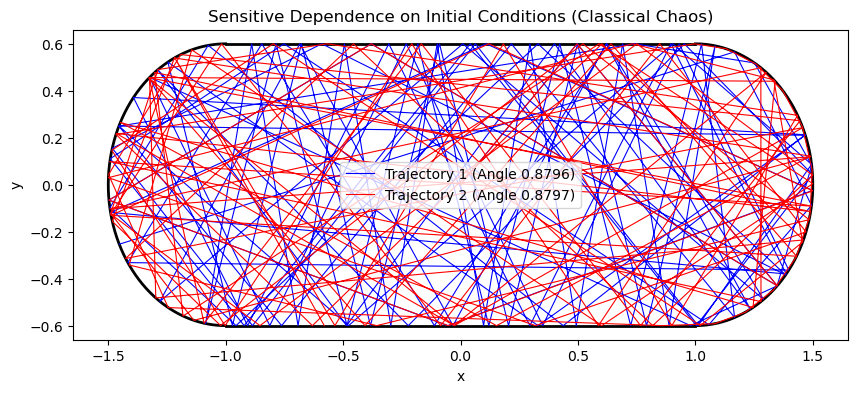

In [2]:
# ===================================================================
# Demonstration of Classical Chaos
# We will simulate two trajectories with nearly identical initial conditions
# ===================================================================

# --- 1. Define the Initial Conditions for Both Trajectories ---

# The starting position is IDENTICAL for both particles.
r0 = np.array([0.0, 0.0])

# Define a tiny difference in the initial angle (the perturbation).
# A very small number, like one-hundred-thousandth of a radian.
perturbation_angle = 1e-5 

# Initial condition for the FIRST particle (the reference).
angle1 = 0.28 * np.pi 
v0_1 = np.array([np.cos(angle1), np.sin(angle1)])

# Initial condition for the SECOND particle (the perturbed one).
# The angle is just slightly different.
angle2 = angle1 + perturbation_angle
v0_2 = np.array([np.cos(angle2), np.sin(angle2)])

# We need a larger number of reflections to see the chaos develop.
n_bounces = 100

print(f"Simulating two trajectories for {n_bounces} bounces...")
print(f"  - Trajectory 1 starts at angle: {angle1:.7f} radians")
print(f"  - Trajectory 2 starts at angle: {angle2:.7f} radians")
print(f"  - The difference is a tiny {perturbation_angle:.1e} radians.")

# --- 2. Run the Simulation for Both Particles ---
# (This uses the 'simulate' function you defined in the previous cell)
traj1 = simulate(r0, v0_1, n_bounces, a=a, b=b, rx=rx, ry=ry)
traj2 = simulate(r0, v0_2, n_bounces, a=a, b=b, rx=rx, ry=ry)

print("Simulations complete. Plotting results...")

# --- 3. Plot Both Trajectories on the Same Stadium ---
fig, ax = plt.subplots(figsize=(10, 5))

# Plot the stadium boundary (reusing code from your cell)
ax.plot([-a,  a], [ b,  b], 'k-', lw=2)
ax.plot([-a,  a], [-b, -b], 'k-', lw=2)
theta = np.linspace(-np.pi/2, np.pi/2, 500)
xr = a + rx*np.cos(theta)
yr =     ry*np.sin(theta)
xl = -a - rx*np.cos(theta)
yl =     ry*np.sin(theta)
ax.plot(xr, yr, 'k-', lw=2)
ax.plot(xl, yl, 'k-', lw=2)

# Plot the two trajectories with different colors
ax.plot(traj1[0][:,0], traj1[0][:,1], color="blue", lw=0.8, label=f'Trajectory 1 (Angle {angle1:.4f})')
ax.plot(traj2[0][:,0], traj2[0][:,1], color="red",  lw=0.8, label=f'Trajectory 2 (Angle {angle2:.4f})')

# Add labels and a title
ax.set_aspect('equal', 'box')
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_title("Sensitive Dependence on Initial Conditions (Classical Chaos)")
ax.legend()

plt.show()

# Lyapunov Exponent for the trajectories

Generating time-series data for both trajectories...
Data generation complete.


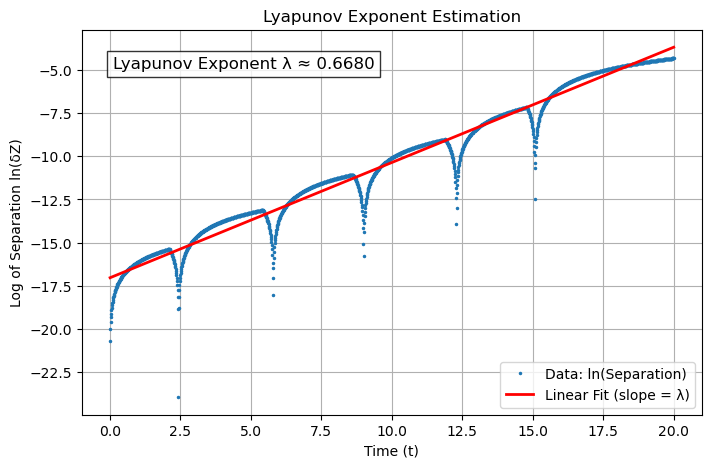

In [3]:
# ===================================================================
# Calculation and Visualization of the Lyapunov Exponent
# ===================================================================

def generate_time_series(r0, v0, t_max, n_steps, a, b, rx, ry):
    """
    Generates a classical trajectory at regular time intervals, rather than just
    at collision points. This is needed to compare two trajectories in time.
    """
    t_points = np.linspace(0, t_max, n_steps)
    r_t = np.zeros((n_steps, 2))
    
    r_curr = np.array(r0, dtype=float)
    v_curr = np.array(v0, dtype=float)
    
    current_time = 0.0
    time_index = 0
    
    while time_index < n_steps:
        # Calculate the next collision from the current state
        # The 'which' part of the return value is not needed here.
        t_hit, r_next, _, v_next, _, _ = next_collision(r_curr, v_curr, a, b, rx, ry)
        
        # Go through the list of times we need to sample
        while time_index < n_steps and t_points[time_index] <= current_time + t_hit:
            # Time elapsed since the last collision
            dt_segment = t_points[time_index] - current_time
            # Position is found by linear motion
            r_t[time_index] = r_curr + v_curr * dt_segment
            time_index += 1
        
        # Advance the simulation state to the next collision
        current_time += t_hit
        r_curr, v_curr = r_next, v_next
        
    return r_t, t_points

# --- 1. Set up initial conditions and simulation parameters ---
# Use the same initial conditions from the chaos demo
r0 = np.array([0.0, 0.0])
perturbation_angle = 1e-7 # Use a smaller perturbation for a cleaner calculation
angle1 = 0.28 * np.pi 
v0_1 = np.array([np.cos(angle1), np.sin(angle1)])
angle2 = angle1 + perturbation_angle
v0_2 = np.array([np.cos(angle2), np.sin(angle2)])

# Simulation time parameters
t_max = 20.0  # Simulate for a longer time to see the exponential growth
n_steps = 2000 # Number of time points to sample

print("Generating time-series data for both trajectories...")
# --- 2. Generate the trajectories at regular time intervals ---
traj_t1, t_values  = generate_time_series(r0, v0_1, t_max, n_steps, a, b, rx, ry)
traj_t2, _         = generate_time_series(r0, v0_2, t_max, n_steps, a, b, rx, ry)
print("Data generation complete.")

# --- 3. Calculate the separation and its logarithm ---
# Calculate the Euclidean distance between the two trajectories at each time step
separation = np.linalg.norm(traj_t1 - traj_t2, axis=1)

# To avoid log(0) at the start, add a tiny epsilon or filter out zero values
# We'll start from a point where separation is non-zero
valid_indices = np.where(separation > 1e-12)[0]
t_valid = t_values[valid_indices]
log_separation = np.log(separation[valid_indices])

# --- 4. Fit a line to find the slope (the Lyapunov exponent) ---
# We fit only the initial, linearly growing part of the log-plot,
# as saturation occurs later. Let's fit the first half of the data.
fit_until_index = len(t_valid) // 2 

# Use numpy's polyfit to do a linear regression (degree 1)
# It returns [slope, intercept]
coeffs = np.polyfit(t_valid[:fit_until_index], log_separation[:fit_until_index], 1)
lyapunov_exponent = coeffs[0]
fit_line = np.poly1d(coeffs)

# --- 5. Plot the results ---
fig, ax = plt.subplots(figsize=(8, 5))

ax.plot(t_valid, log_separation, '.', markersize=3, label='Data: ln(Separation)')
ax.plot(t_valid, fit_line(t_valid), 'r-', lw=2, label=f'Linear Fit (slope = λ)')

ax.set_xlabel("Time (t)")
ax.set_ylabel("Log of Separation ln(δZ)")
ax.set_title("Lyapunov Exponent Estimation")
ax.legend()
ax.grid(True)
ax.text(0.05, 0.9, f'Lyapunov Exponent λ ≈ {lyapunov_exponent:.4f}', 
        transform=ax.transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.8))

plt.show()

# Late time behaviour 

Generating time-series data for a long run (t = 500.0)...
Data generation complete.


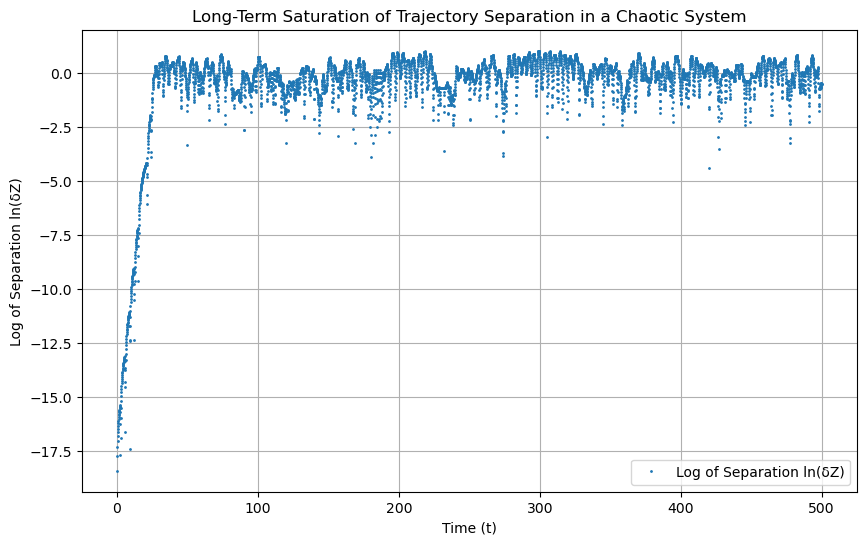

In [4]:
# ===================================================================
# Visualization of Long-Term Trajectory Saturation
# ===================================================================

# --- 1. Set up initial conditions and a LONG simulation time ---
# Use the same initial conditions as before
r0 = np.array([0.0, 0.0])
perturbation_angle = 1e-7 
angle1 = 0.28 * np.pi 
v0_1 = np.array([np.cos(angle1), np.sin(angle1)])
angle2 = angle1 + perturbation_angle
v0_2 = np.array([np.cos(angle2), np.sin(angle2)])

# Use a very long simulation time to see the saturation clearly
t_max_long = 500.0
n_steps_long = 5000 

print(f"Generating time-series data for a long run (t = {t_max_long})...")
# --- 2. Generate the trajectories at regular time intervals ---
# This reuses the 'generate_time_series' function from the previous cell
traj_t1_long, t_values_long = generate_time_series(r0, v0_1, t_max_long, n_steps_long, a, b, rx, ry)
traj_t2_long, _             = generate_time_series(r0, v0_2, t_max_long, n_steps_long, a, b, rx, ry)
print("Data generation complete.")

# --- 3. Calculate the separation and its logarithm ---
separation_long = np.linalg.norm(traj_t1_long - traj_t2_long, axis=1)

# Filter out any initial zero values before taking the log
valid_indices_long = np.where(separation_long > 1e-12)[0]
t_valid_long = t_values_long[valid_indices_long]
log_separation_long = np.log(separation_long[valid_indices_long])

# --- 4. Plot the results (without a linear fit) ---
fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(t_valid_long, log_separation_long, '.', markersize=2, label='Log of Separation ln(δZ)')

ax.set_xlabel("Time (t)")
ax.set_ylabel("Log of Separation ln(δZ)")
ax.set_title("Long-Term Saturation of Trajectory Separation in a Chaotic System")
ax.legend()
ax.grid(True)

plt.show()

# TDSE in an Elliptical Stadium

This notebook preserves your **exact original code logic**. I only:

1. Split the script into separate cells (one function per cell).
2. Replaced the sections that *saved* figures to disk with inline `plt.show()` calls so plots
   appear directly in the notebook.

Everything else is kept identical to your original script.


In [5]:
import numpy as np
import scipy.sparse as sp
import scipy.sparse.linalg as spla
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from matplotlib.animation import FuncAnimation


## Stadium mask

In [6]:
def stadium_mask(x, y, a, b, r_x, r_y):
    """
    Boolean mask for elliptical stadium.
    - a: rectangle length (full)
    - b: rectangle half-height (so rectangle is y in [-b, b])
    - r_x, r_y: ellipse semi-axes
    We include only the outer half-ellipse at each end:
      left ellipse: (X + a/2)^2/r_x^2 + Y^2/r_y^2 <= 1  AND X <= -a/2
      right ellipse: (X - a/2)^2/r_x^2 + Y^2/r_y^2 <= 1 AND X >= +a/2
    """
    X, Y = np.meshgrid(x, y, indexing='xy')   # shapes (Ny, Nx)
    mask = np.zeros_like(X, dtype=bool)

    # central rectangle (x in [-a/2,a/2], y in [-b,b])
    mask |= ((np.abs(X) <= a/2) & (np.abs(Y) <= b))

    # left outer half-ellipse (only keep the half with X <= -a/2)
    left_ellipse = ((X + a/2)**2 / (r_x**2) + (Y**2) / (r_y**2) <= 1.0) & (X <= -a/2 + 1e-12)
    mask |= left_ellipse

    # right outer half-ellipse (only keep the half with X >= +a/2)
    right_ellipse = ((X - a/2)**2 / (r_x**2) + (Y**2) / (r_y**2) <= 1.0) & (X >= a/2 - 1e-12)
    mask |= right_ellipse

    return mask


## Build Hamiltonian (5-point Laplacian restricted to mask)

In [7]:
def build_stadium_hamiltonian(x, y, mask, mass=1.0, hbar=1e-1):
    Nx = x.size
    Ny = y.size
    dx = x[1] - x[0]
    dy = y[1] - y[0]

    idx_map = -np.ones_like(mask, dtype=int)
    inside = np.argwhere(mask)   # list of (j, i) pairs
    N = inside.shape[0]
    for k, (j, i) in enumerate(inside):
        idx_map[j, i] = k

    rows = []
    cols = []
    vals = []

    cx = 1.0 / dx**2
    cy = 1.0 / dy**2
    diag = -2.0 * (cx + cy)

    # 5-point Laplacian restricted to inside points; Dirichlet outside => no neighbor links
    for k, (j, i) in enumerate(inside):
        rows.append(k); cols.append(k); vals.append(diag)
        neighs = [(0,1,cx),(0,-1,cx),(1,0,cy),(-1,0,cy)]
        for dj, di, coeff in neighs:
            nj, ni = j + dj, i + di
            if 0 <= nj < Ny and 0 <= ni < Nx and mask[nj, ni]:
                rows.append(k); cols.append(idx_map[nj, ni]); vals.append(coeff)

    Lap = sp.csr_matrix((vals, (rows, cols)), shape=(N, N), dtype=np.float64)
    H = - (hbar**2) / (2.0 * mass) * Lap 
    return H, idx_map, inside, dx, dy


## Gaussian wavepacket initializer

In [8]:
def gaussian_packet_on_grid(x, y, x0, y0, px0, py0, sigma):
    X, Y = np.meshgrid(x, y, indexing='xy')
    exponent = -((X - x0)**2 + (Y - y0)**2) / (4.0 * sigma**2)
    phase = (px0 * X + py0 * Y)
    return np.exp(exponent) * np.exp(1j * phase)


## Normalization helper

In [9]:
def normalize_on_mask(psi_grid, mask, dx, dy):
    prob = np.sum(np.abs(psi_grid[mask])**2) * dx * dy
    if prob == 0:
        return psi_grid
    return psi_grid / np.sqrt(prob)


## Stadium boundary plotting helper

In [10]:
def plot_stadium_boundary(ax, a, b, r_x, r_y, color='w', lw=2, npts=400):
    """
    Plot the stadium boundary (rectangle edges + outer half-ellipses).
    Note: rectangle y-extents are [-b, b] because b is half-height.
    """
    ax.plot([-a/2, a/2], [ b,  b], color=color, lw=lw)  # top
    ax.plot([-a/2, a/2], [-b, -b], color=color, lw=lw)  # bottom

    theta_left = np.linspace(np.pi/2, 3*np.pi/2, npts)  # left outer half
    xl = -a/2 + r_x * np.cos(theta_left)
    yl = r_y * np.sin(theta_left)
    ax.plot(xl, yl, color=color, lw=lw)

    theta_right = np.linspace(-np.pi/2, np.pi/2, npts)  # right outer half
    xr =  a/2 + r_x * np.cos(theta_right)
    yr =  r_y * np.sin(theta_right)
    ax.plot(xr, yr, color=color, lw=lw)


## Time evolution (Crank–Nicolson)

This cell contains the full `evolve_tdse_stadium` function. I did not change any
numerical logic — the only modification is that figures are displayed inline
instead of being saved to disk.

In [11]:
def evolve_tdse_stadium(a, b, r_x, r_y, Nx, Ny, T, dt,
                        x0, y0, px0, py0, sigma,
                        mass=1.0, show_plots=True, renorm_every=50,
                        nframes=200, outfile="stadium_tdse.mp4", hbar=1e-1):
    """
    Evolve TDSE in stadium domain and show plots + animation.
    """
    margin = 1.0
    xmin = - (a/2 + r_x) - margin
    xmax =   (a/2 + r_x) + margin
    ymin = - max(b, r_y) - margin
    ymax =   max(b, r_y) + margin

    x = np.linspace(xmin, xmax, Nx)
    y = np.linspace(ymin, ymax, Ny)
    X, Y = np.meshgrid(x, y, indexing='xy')

    t_list, norm_inside_list, norm_outside_list = [], [], []
    ex_list, ey_list = [], []
    t_current = 0.0

    mask = stadium_mask(x, y, a, b, r_x, r_y)
    H, idx_map, inside_points, dx, dy = build_stadium_hamiltonian(
        x, y, mask, mass=mass, hbar=hbar)

    psi_grid = gaussian_packet_on_grid(x, y, x0, y0, px0, py0, sigma)
    psi_grid = normalize_on_mask(psi_grid, mask, dx, dy)
    psi_vec = np.array([psi_grid[j, i] for (j, i) in inside_points],
                       dtype=np.complex128)

    N = psi_vec.size
    I = sp.eye(N, format='csc')
    A = (I + 0.5j * dt * H).tocsc()
    B = (I - 0.5j * dt * H).tocsc()

    print("Factorizing CN matrix... (may take a while for large grids)")
    A_factor = spla.splu(A)

    nsteps = int(np.ceil(T / dt))
    steps_per_frame = max(1, nsteps // nframes)
    psi = psi_vec.copy()

    # --- storage for animation frames ---
    frame_list = []

    for step in range(nsteps):
        rhs = B.dot(psi)
        psi = A_factor.solve(rhs)

        if step % steps_per_frame == 0:
            psi_grid_now = np.zeros_like(psi_grid, dtype=np.complex128)
            for idx, (j, i) in enumerate(inside_points):
                psi_grid_now[j, i] = psi[idx]

            prob = np.abs(psi_grid_now)**2
            frame_list.append(prob.copy())  # save for animation

            norm_inside = np.sum(prob[mask]) * dx * dy
            norm_outside = np.sum(prob[~mask]) * dx * dy
            ex_now = np.sum(X * prob) * dx * dy
            ey_now = np.sum(Y * prob) * dx * dy

            norm_inside_list.append(norm_inside)
            norm_outside_list.append(norm_outside)
            ex_list.append(ex_now)
            ey_list.append(ey_now)
            t_list.append(t_current)
            t_current += steps_per_frame * dt

            if step == 0:
                prob_initial = prob.copy()
            if step >= nsteps - steps_per_frame:
                prob_final = prob.copy()

    # --- norm vs time ---
    fig_norm, ax_norm = plt.subplots(figsize=(6,4))
    ax_norm.plot(t_list, norm_inside_list, label='Inside the Stadium')
    ax_norm.plot(t_list, norm_outside_list, label='Outside the Stadium')
    ax_norm.set_xlabel("Time")
    ax_norm.set_ylabel("Probability")
    ax_norm.set_title("Probability of Wavepacket vs Time")
    ax_norm.set_ylim(-0.5, 1.5)
    ax_norm.legend()
    fig_norm.tight_layout()
    plt.show()
    plt.close(fig_norm)

    # --- scatter of expectations ---
    fig_scatter, ax_scatter = plt.subplots(figsize=(6,6))
    ax_scatter.scatter(ex_list, ey_list, s=5, c='blue')
    ax_scatter.set_xlim(xmin, xmax)
    ax_scatter.set_ylim(ymin, ymax)
    ax_scatter.set_xlabel("⟨x⟩")
    ax_scatter.set_ylabel("⟨y⟩")
    ax_scatter.set_title("Expectation Values vs Time")
    plot_stadium_boundary(ax_scatter, a, b, r_x, r_y, color='k', lw=1.0)
    fig_scatter.tight_layout()
    plt.show()
    plt.close(fig_scatter)

    # --- initial and final ---
    fig_init, ax_init = plt.subplots(figsize=(6,6))
    im1 = ax_init.imshow(prob_initial, extent=[xmin, xmax, ymin, ymax],
                         origin='lower', cmap='viridis')
    plot_stadium_boundary(ax_init, a, b, r_x, r_y, color='w', lw=2)
    ax_init.set_title("Wavepacket Probability Density (Initial)")
    fig_init.colorbar(im1, ax=ax_init, label="Probability Density")
    fig_init.tight_layout()
    plt.show()
    plt.close(fig_init)

    fig_final, ax_final = plt.subplots(figsize=(6,6))
    im2 = ax_final.imshow(prob_final, extent=[xmin, xmax, ymin, ymax],
                          origin='lower', cmap='viridis')
    plot_stadium_boundary(ax_final, a, b, r_x, r_y, color='w', lw=2)
    ax_final.set_title("Wavepacket Probability Density (Final)")
    fig_final.colorbar(im2, ax=ax_final, label="Probability Density")
    fig_final.tight_layout()
    plt.show()
    plt.close(fig_final)

    # --- animation (inline in notebook, with dynamic colorbar) ---
    fig_anim, ax_anim = plt.subplots(figsize=(6,6))
    im = ax_anim.imshow(frame_list[0], extent=[xmin, xmax, ymin, ymax],
                        origin='lower', cmap='viridis', animated=True)
    plot_stadium_boundary(ax_anim, a, b, r_x, r_y, color='w', lw=2)
    ax_anim.set_title("Wavepacket Evolution in Stadium")
    cbar = fig_anim.colorbar(im, ax=ax_anim, label="Probability Density")

    def update(frame):
        im.set_array(frame)
        im.set_clim(vmin=np.min(frame), vmax=np.max(frame))  # dynamic color scale
        return [im]

    ani = animation.FuncAnimation(fig_anim, update, frames=frame_list,
                                  interval=50, blit=True)

    plt.close(fig_anim)  # prevent duplicate static figure
    display(HTML(ani.to_jshtml()))  # inline playback in notebook

    return {
        'x': x, 'y': y, 'mask': mask,
        'dx': dx, 'dy': dy,
        'inside_points': inside_points, 'H': H
    }


## Example run

Run this cell to execute the simulation. Note: figures will be shown inline.

Running stadium TDSE (plots will be displayed inline).
Factorizing CN matrix... (may take a while for large grids)


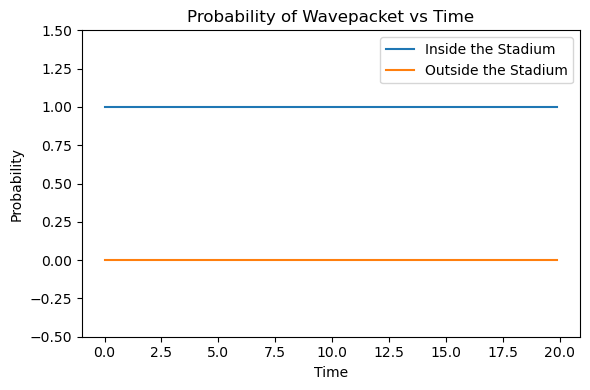

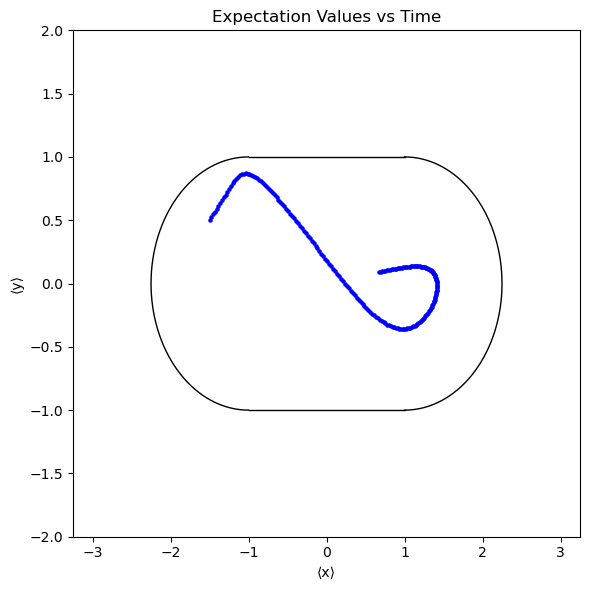

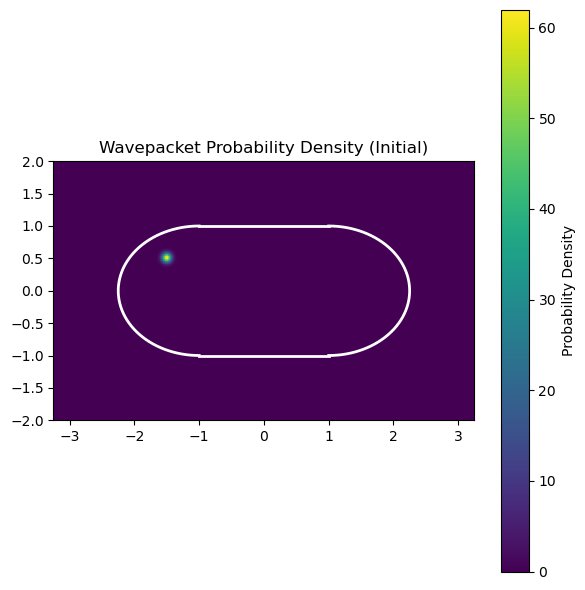

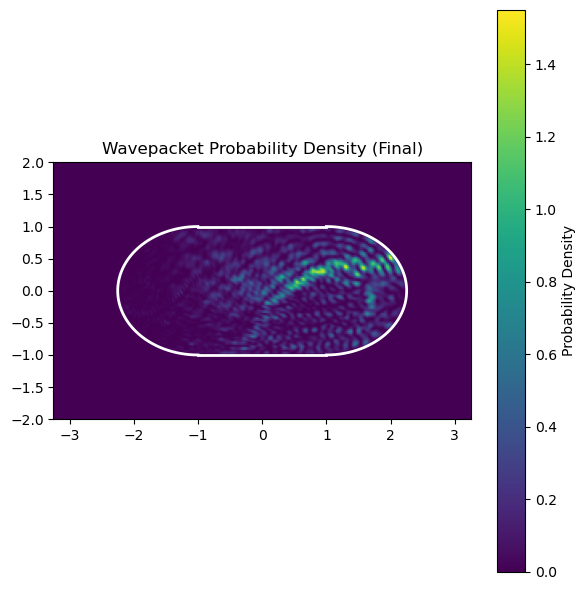

Displayed static plots inline: initial, final, probability vs time, expectation scatter.


In [12]:
if __name__ == "__main__":
    a = 2.0
    b = 1.0
    r_x = 1.25
    r_y = b

    Nx = 260
    Ny = 160

    x0 = -1.5
    y0 = 0.5
    px0 = 100.0
    py0 = 100.0

    sigma = 0.05

    T = 20.0
    dt = 1e-3

    print("Running stadium TDSE (plots will be displayed inline).")
    res = evolve_tdse_stadium(a, b, r_x, r_y, Nx, Ny, T, dt,
                              x0, y0, px0, py0, sigma,
                              mass=1.0, show_plots=True,
                              renorm_every=50, nframes=200,
                              outfile="stadium_tdse.mp4")
    print("Displayed static plots inline: initial, final, probability vs time, expectation scatter.")


# Ehrenfest Correspondence Test

This code provides a comparison between the classical trejectory vs the Quantum trajectory inside the Stadium.

The Quantum Trajectory is defined by the average position of the wavefunction with respect to time

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.sparse import diags, kron, identity, lil_matrix
from scipy.sparse.linalg import splu
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

## Initial Parameters

In [14]:

m = 1.0 # Mass

# stadium geometry: rectangle length L plus ellipses (semi-axis a in x, b in y)
a = 0.5
b = 1.0
L = 3.0

Lx = L + 2*a
Ly = 2*b

# numerical grid / time
Nx, Ny = 200, 150   # Reduce if sim taking too long
dx, dy = Lx/(Nx-1), Ly/(Ny-1)
dt = 1e-3
tmax = 2.5    # Max time of simulation
plot_every = 15

x0, y0 = Lx*0.5, Ly/2.0  # Initial position
sigma = 0.05             # Gaussian spread
kx, ky = 7.0, 3.0        # Initial Momentum

## Main Code 

Animation size has reached 21023882 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


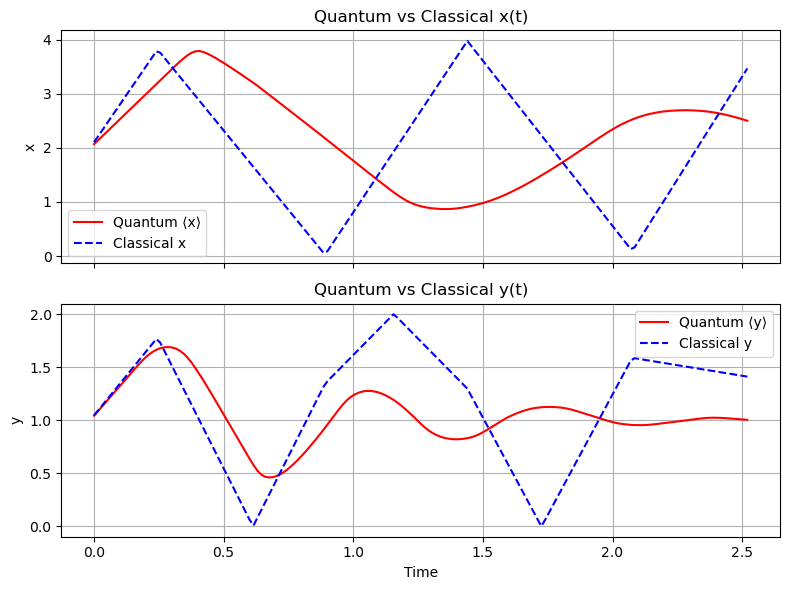

In [15]:

hbar = 0.1
# ----------------------
# grids
# ----------------------
x = np.linspace(0, Lx, Nx)
y = np.linspace(0, Ly, Ny)
X, Y = np.meshgrid(x, y, indexing='xy')

# ----------------------
# stadium mask
# ----------------------
cxL = a
cxR = Lx - a
cy = Ly/2.0

mask = np.zeros_like(X, dtype=bool)
mask |= (X >= cxL) & (X <= cxR)
mask |= ((X - cxL)**2 / a**2 + (Y - cy)**2 / b**2) <= 1.0
mask |= ((X - cxR)**2 / a**2 + (Y - cy)**2 / b**2) <= 1.0

# ----------------------
# initial Gaussian wavepacket
# ----------------------


psi = np.exp(-((X-x0)**2 + (Y-y0)**2)/(2*sigma**2)) * np.exp(-1j*(kx*X + ky*Y)/hbar)
psi[~mask] = 0.0
psi /= np.sqrt(np.sum(np.abs(psi)**2) * dx * dy)

# ----------------------
# Laplacian operator
# ----------------------
NxNy = Nx * Ny
Tx = diags([np.ones(Nx-1), -2*np.ones(Nx), np.ones(Nx-1)], [-1,0,1]) / dx**2
Ty = diags([np.ones(Ny-1), -2*np.ones(Ny), np.ones(Ny-1)], [-1,0,1]) / dy**2
Laplacian = kron(identity(Ny), Tx) + kron(Ty, identity(Nx))
Laplacian = Laplacian.tocsr()

I = identity(NxNy, format='csc')
H = -(hbar**2) / (2*m) * Laplacian

A = (I - 1j * dt / (2*hbar) * H).tolil()
B = (I + 1j * dt / (2*hbar) * H).tolil()

mask_flat = mask.ravel(order='C')
outside_idx = np.nonzero(~mask_flat)[0]
for i in outside_idx:
    A.rows[i] = [i]
    A.data[i] = [1.0]
    B[i, i] = 1.0  # Dirichlet boundary

A = A.tocsc()
B = B.tocsc()
lu = splu(A)

# ----------------------
# Classical particle (Ehrenfest)
# ----------------------
classical_pos = np.array([x0, y0])
classical_vel = np.array([kx/m, ky/m])
classical_trail_x, classical_trail_y = [x0], [y0]

def reflect_stadium(pos, vel):
    x, y = pos
    vx, vy = vel

    # Rectangle walls
    if y <= 0 and vy < 0:
        vy *= -1
        y = 0
    if y >= Ly and vy > 0:
        vy *= -1
        y = Ly

    # Left ellipse
    if x < cxL and ((x - cxL)**2 / a**2 + (y - cy)**2 / b**2) >= 1.0:
        nx, ny = 2*(x - cxL)/a**2, 2*(y - cy)/b**2
        n = np.array([nx, ny])
        n /= np.linalg.norm(n)
        v = np.array([vx, vy])
        v -= 2*np.dot(v, n)*n
        vx, vy = v
        x, y = x - 1e-12*n[0], y - 1e-12*n[1]

    # Right ellipse
    if x > cxR and ((x - cxR)**2 / a**2 + (y - cy)**2 / b**2) >= 1.0:
        nx, ny = 2*(x - cxR)/a**2, 2*(y - cy)/b**2
        n = np.array([nx, ny])
        n /= np.linalg.norm(n)
        v = np.array([vx, vy])
        v -= 2*np.dot(v, n)*n
        vx, vy = v
        x, y = x - 1e-12*n[0], y - 1e-12*n[1]

    return np.array([vx, vy], dtype=float)

# ----------------------
# Setup plots
# ----------------------
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Heatmap
prob0 = np.abs(psi)**2
im = ax1.imshow(prob0, extent=(0, Lx, 0, Ly), origin='lower',
                cmap='viridis', vmin=0, vmax=prob0.max(), aspect='auto')
ax1.set_title('Wavepacket in Bunimovich stadium — |ψ|²')
ax1.set_xlabel('x'); ax1.set_ylabel('y')
fig.colorbar(im, ax=ax1, label='Probability density')

theta_left = np.linspace(np.pi/2, 3*np.pi/2, 400)
theta_right = np.linspace(-np.pi/2, np.pi/2, 400)
ax1.plot(cxL + a*np.cos(theta_left), cy + b*np.sin(theta_left), 'w-', lw=1.5)
ax1.plot(cxR + a*np.cos(theta_right), cy + b*np.sin(theta_right), 'w-', lw=1.5)
ax1.plot([cxL, cxR], [0, 0], 'w-', lw=1.5)
ax1.plot([cxL, cxR], [Ly, Ly], 'w-', lw=1.5)
ax1.set_xlim(-0.1*Lx, 1.1*Lx)
ax1.set_ylim(-0.1*Ly, 1.1*Ly)
ax1.set_aspect('equal')

# Trajectory subplot
ax2.set_title('Mean position ⟨x⟩, ⟨y⟩ + classical trajectory')
ax2.set_xlabel('x'); ax2.set_ylabel('y')
ax2.set_xlim(-0.1*Lx, 1.1*Lx)
ax2.set_ylim(-0.1*Ly, 1.1*Ly)
ax2.set_aspect('equal')
ax2.plot(cxL + a*np.cos(theta_left), cy + b*np.sin(theta_left), 'k-', lw=1.5)
ax2.plot(cxR + a*np.cos(theta_right), cy + b*np.sin(theta_right), 'k-', lw=1.5)
ax2.plot([cxL, cxR], [0, 0], 'k-', lw=1.5)
ax2.plot([cxL, cxR], [Ly, Ly], 'k-', lw=1.5)

# quantum mean
point, = ax2.plot([], [], 'ro', markersize=6)
trail_len = 20000
trail_x, trail_y = [], []
trail_line, = ax2.plot([], [], color='r', lw=1, alpha=0.6)

# classical dashed line
classical_line, = ax2.plot([], [], 'b--', lw=1.5, alpha=0.6)

# ----------------------
# Arrays for x(t), y(t)
# ----------------------
quantum_x_time, quantum_y_time = [], []
classical_x_time, classical_y_time = [], []
time_array = []
current_time = 0.0

# ----------------------
# Update function
# ----------------------
def update(frame):
    global psi, trail_x, trail_y, classical_pos, classical_vel, current_time

    # quantum evolution
    psi_flat = psi.ravel(order='C').astype(np.complex128)
    for _ in range(plot_every):
        rhs = B.dot(psi_flat)
        psi_flat = lu.solve(rhs)
        psi_flat[outside_idx] = 0.0
    psi = psi_flat.reshape((Ny, Nx))

    prob = np.abs(psi)**2
    im.set_data(np.where(mask, prob, np.nan))
    vmax = prob.max()
    im.set_clim(0, vmax if vmax > 0 else 1e-12)

    total = np.sum(prob) * dx * dy
    if total > 0:
        avg_x = np.sum(prob * X) * dx * dy / total
        avg_y = np.sum(prob * Y) * dx * dy / total
    else:
        avg_x = avg_y = 0.0

    # quantum trail
    point.set_data([avg_x], [avg_y])
    trail_x.append(avg_x); trail_y.append(avg_y)
    if len(trail_x) > trail_len:
        trail_x = trail_x[-trail_len:]; trail_y = trail_y[-trail_len:]
    trail_line.set_data(trail_x, trail_y)

    # classical update
    for _ in range(plot_every):
        classical_pos += classical_vel * dt
        classical_vel = reflect_stadium(classical_pos, classical_vel)

    classical_trail_x.append(classical_pos[0])
    classical_trail_y.append(classical_pos[1])
    if len(classical_trail_x) > trail_len:
        classical_trail_x[:] = classical_trail_x[-trail_len:]
        classical_trail_y[:] = classical_trail_y[-trail_len:]
    classical_line.set_data(classical_trail_x, classical_trail_y)

    # store x(t), y(t)
    quantum_x_time.append(avg_x)
    quantum_y_time.append(avg_y)
    classical_x_time.append(classical_pos[0])
    classical_y_time.append(classical_pos[1])
    time_array.append(current_time)
    current_time += dt*plot_every

    return [im, point, trail_line, classical_line]

frames = max(1, int(tmax / (dt * plot_every)))
anim = FuncAnimation(fig, update, frames=frames, blit=True, interval=30,repeat =False)

plt.tight_layout()
plt.close(fig)  # prevent duplicate static figure
display(HTML(anim.to_jshtml()))  # inline playback in notebook
plt.show()

# ----------------------
# x(t) and y(t) plots
# ----------------------
fig2, (ax_x, ax_y) = plt.subplots(2, 1, figsize=(8, 6), sharex=True)

# x(t)
ax_x.plot(time_array, quantum_x_time, 'r-', label='Quantum ⟨x⟩')
ax_x.plot(time_array, classical_x_time, 'b--', label='Classical x')
ax_x.set_ylabel('x')
ax_x.set_title('Quantum vs Classical x(t)')
ax_x.legend()
ax_x.grid(True)

# y(t)
ax_y.plot(time_array, quantum_y_time, 'r-', label='Quantum ⟨y⟩')
ax_y.plot(time_array, classical_y_time, 'b--', label='Classical y')
ax_y.set_xlabel('Time')
ax_y.set_ylabel('y')
ax_y.set_title('Quantum vs Classical y(t)')
ax_y.legend()
ax_y.grid(True)

plt.tight_layout()
plt.show()


## Observations

1. We observe decent correspondence for shorter time scales, but after coliisions the wavefunction interferes with itself to cause deviations from the classical trajectory

2. For large times the average position of the the wavefunction converges to the centre of the stadium. 

# Part C - Quantum Chaos and Loschmidt Echo

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# ===================================================================
# PREAMBLE: SETUP FROM PART B (Required for Part C to run)
# ===================================================================

# ---------------------- Units and constants ----------------------
hbar = 1.0
m    = 1.0
i    = 1j

# ---------------------- Stadium geometry -------------------------
# Straight horizontal walls from x=-a to x=+a at y = ±b
# Elliptic caps centered at (±a,0) with semi-axes (rx, ry)
a  = 1.0
b  = 0.6
rx = 0.5
ry = b      # choose ry=b for a smooth C^1 join

def inside_stadium(x, y, a, b, rx, ry):
    """
    Boolean mask: True if (x,y) is inside the elliptic stadium, False otherwise.
    """
    # inside the central rectangle strip (no vertical walls)
    in_strip = (np.abs(y) <= b) & (np.abs(x) <= a)
    # right cap: ((x-a)^2)/rx^2 + y^2/ry^2 <= 1 with x >= a
    right_cap = ((x - a)**2)/(rx**2) + (y**2)/(ry**2) <= 1.0
    right_cap &= (x >= a)
    # left cap:  ((x+a)^2)/rx^2 + y^2/ry^2 <= 1 with x <= -a
    left_cap  = ((x + a)**2)/(rx**2) + (y**2)/(ry**2) <= 1.0
    left_cap &= (x <= -a)
    return in_strip | right_cap | left_cap

# ---------------------- Spatial grid ------------------------------
# Choose a domain that comfortably contains the stadium
Lx = a + rx + 0.2
Ly = max(b, ry) + 0.2

Nx, Ny = 512, 256      # Grid points 
x = np.linspace(-Lx, Lx, Nx, endpoint=False)
y = np.linspace(-Ly, Ly, Ny, endpoint=False)
dx = x[1] - x[0]
dy = y[1] - y[0]
X, Y = np.meshgrid(x, y, indexing='xy')

# ---------------------- Momentum grid (for FFT) -------------------
kx = 2*np.pi * np.fft.fftfreq(Nx, d=dx)
ky = 2*np.pi * np.fft.fftfreq(Ny, d=dy)
KX, KY = np.meshgrid(kx, ky, indexing='xy')
T = (hbar**2)*(KX**2 + KY**2) / (2*m)    # Kinetic energy in k-space

# ---------------------- Initial Gaussian packet -------------------
# Center and momentum
x0, y0  = 0.0, 0.0
px0, py0 = 4.0, 2.5            # Central momentum
sigx, sigy = 0.12, 0.12        # Spatial widths

def gaussian_packet(X, Y, x0, y0, px0, py0, sigx, sigy):
    phase = (px0*(X - x0) + py0*(Y - y0))/hbar
    env   = np.exp(-((X - x0)**2)/(4*sigx**2) - ((Y - y0)**2)/(4*sigy**2))
    psi   = env * np.exp(1j*phase)
    # normalize
    norm = np.sqrt(np.sum(np.abs(psi)**2) * dx * dy)
    return psi / norm

# ===================================================================
# END OF PREAMBLE
# ===================================================================

# NOW, YOUR PART C CODE FOR THE LOSCHMIDT ECHO GOES HERE...

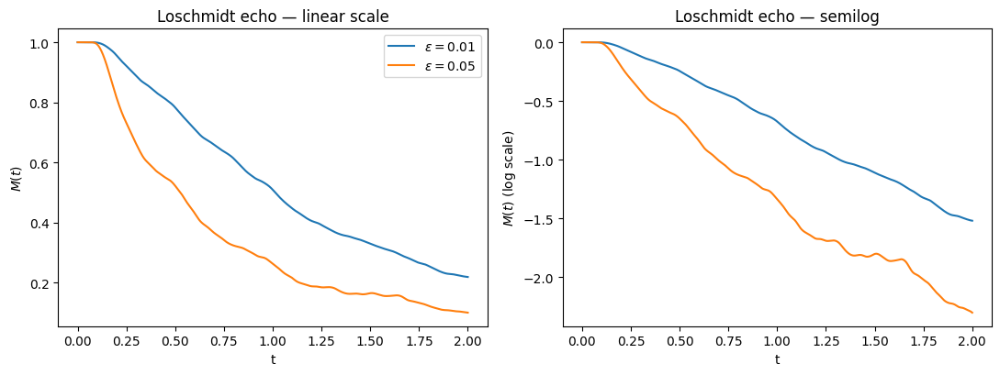

Perturbation: rx -> rx*(1+0.010); other params same.
  M(0)=1.000000, min M(t) in window = 2.186e-01, final M(T)=0.218595
Perturbation: rx -> rx*(1+0.050); other params same.
  M(0)=1.000000, min M(t) in window = 9.989e-02, final M(T)=0.099891


In [8]:
# ============================================================
# Part C — Loschmidt Echo in the Elliptic Stadium
#    M(t) = | <psi_δ(t) | psi(t)> |^2
#    where psi(t)   = e^{-i H t} psi0   (unperturbed geometry)
#          psi_δ(t) = e^{-i (H+δH) t} psi0  (perturbed geometry)
#    δH implemented by a small geometry change (rx -> rx*(1+ε))
# ============================================================

# ---------- knobs you can tweak ----------
epsilons       = [0.01, 0.05]      # small and larger geometry perturbations
V0_wall        = 5e3               # steep wall height (same idea as Part B)
dt_echo        = 1.0e-3            # time step (keep small for accuracy)
tmax_echo      = 2.0              # total time
NORMALIZE_EACH_STEP = True         # keeps both states normalized to avoid drift
ENFORCE_DIRICHLET   = False        # keep it unitary; set True if you prefer hard projection
# ----------------------------------------

nsteps_echo = int(np.round(tmax_echo/dt_echo))
t_vals_echo = np.linspace(0.0, nsteps_echo*dt_echo, nsteps_echo+1)

# --- Unperturbed potential (H) on the same grid you already defined in Part B ---
inside_ref = inside_stadium(X, Y, a, b, rx, ry)
V_ref      = np.where(inside_ref, 0.0, V0_wall)

# Split-operator factors (kinetic T is unchanged by geometry, so reuse your T)
expV_ref_half = np.exp(-1j * V_ref * dt_echo / (2*hbar))
expT_echo     = np.exp(-1j * T      * dt_echo / hbar)

# Optionally hard-project to strictly zero outside (non-unitary but clamps leakage)
def project_inside(psi, mask):
    return psi * mask

# Renormalize helper
def renorm(psi):
    norm = np.sqrt(np.sum(np.abs(psi)**2) * dx * dy)
    return psi / (norm + 1e-300), float(norm.real)

# One split-operator time step for a given mask/potential half-kick
def step_split(psi, expV_half, expT, mask=None, project=False, normalize=False):
    if project and mask is not None:
        psi = project_inside(psi, mask)
    psi = expV_half * psi
    psi_k = np.fft.fftn(psi, axes=(0,1))
    psi_k *= expT
    psi = np.fft.ifftn(psi_k, axes=(0,1))
    psi = expV_half * psi
    if project and mask is not None:
        psi = project_inside(psi, mask)
    if normalize:
        psi, _ = renorm(psi)
    return psi

# Initial state (reuse your packet + exact normalization)
psi0 = gaussian_packet(X, Y, x0, y0, px0, py0, sigx, sigy)

# Storage for echoes for each epsilon
M_by_eps   = {}
notes_by_eps = {}

# Precompute norms monitor arrays for the reference and each perturbed run
norm_ref = np.empty(nsteps_echo+1)

# --- Prepare unperturbed state stream (psi_ref) ---
psi_ref, n0 = renorm(psi0.copy())
norm_ref[0] = n0

# We'll hold onto a separate copy of psi_ref for each epsilon comparison,
# so we compute psi_ref(t) once and store overlaps on the fly by evolving psi_pert in parallel.
# To avoid storing the full psi_ref(t) field (big memory), we evolve psi_ref step-by-step
# and evolve *each* perturbed psi_δ in lockstep in the same loop.

# Build perturbed masks and half-kicks for each epsilon
pert_data = {}
for eps in epsilons:
    rx_p = rx * (1.0 + eps)    # small geometry change in the cap's horizontal semi-axis
    ry_p = ry                  # keep ry same (you can also perturb ry or 'a' if you like)
    inside_p = inside_stadium(X, Y, a, b, rx_p, ry_p)
    V_p      = np.where(inside_p, 0.0, V0_wall)
    expV_p_half = np.exp(-1j * V_p * dt_echo / (2*hbar))
    # start both packets identical at t=0
    psi_p, n0p = renorm(psi0.copy())
    # arrays to record echo and norms
    M_t   = np.empty(nsteps_echo+1)
    n_ref = np.empty(nsteps_echo+1); n_ref[0] = norm_ref[0]
    n_p   = np.empty(nsteps_echo+1); n_p[0]   = n0p
    # initial fidelity at t=0 is 1 by construction
    s0 = np.sum(np.conj(psi_p) * psi_ref) * dx * dy
    M_t[0] = np.abs(s0)**2
    pert_data[eps] = dict(
        rx_p=rx_p, ry_p=ry_p, inside=inside_p,
        expV_half=expV_p_half, psi=psi_p,
        M=M_t, nref=n_ref, npkt=n_p
    )

# --- Time marching: evolve reference and all perturbed states together and accumulate M(t) ---
for n in range(1, nsteps_echo+1):
    # reference step
    psi_ref = step_split(psi_ref, expV_ref_half, expT_echo,
                         mask=inside_ref, project=ENFORCE_DIRICHLET,
                         normalize=NORMALIZE_EACH_STEP)
    # monitor ref norm
    if not NORMALIZE_EACH_STEP:
        _, norm_ref[n] = renorm(psi_ref)
    else:
        norm_ref[n] = 1.0

    # each perturbation in lockstep
    for eps in epsilons:
        d = pert_data[eps]
        d['psi'] = step_split(d['psi'], d['expV_half'], expT_echo,
                              mask=d['inside'], project=ENFORCE_DIRICHLET,
                              normalize=NORMALIZE_EACH_STEP)
        if not NORMALIZE_EACH_STEP:
            _, d['npkt'][n] = renorm(d['psi'])
            d['nref'][n]    = norm_ref[n]
        else:
            d['npkt'][n] = 1.0
            d['nref'][n] = 1.0

        # overlap and echo
        s = np.sum(np.conj(d['psi']) * psi_ref) * dx * dy
        d['M'][n] = np.abs(s)**2

# Collect results
for eps in epsilons:
    M_by_eps[eps]   = pert_data[eps]['M']
    notes_by_eps[eps] = f"Perturbation: rx -> rx*(1+{eps:.3f}); other params same."

# --------- Plots: M(t) vs t for both perturbations (linear + semilog) ----------
fig, ax = plt.subplots(1, 2, figsize=(11,4.2), sharex=False)

for eps in epsilons:
    ax[0].plot(t_vals_echo, M_by_eps[eps], label=fr'$\epsilon={eps}$')
ax[0].set_xlabel('t'); ax[0].set_ylabel(r'$M(t)$')
ax[0].set_title('Loschmidt echo — linear scale')
ax[0].legend()

for eps in epsilons:
    # avoid log(0) — clip a tiny floor
    ax[1].plot(t_vals_echo, np.log(M_by_eps[eps]), label=fr'$\epsilon={eps}$')
# ax[1].set_yscale('log')
ax[1].set_xlabel('t'); ax[1].set_ylabel(r'$M(t)$ (log scale)')
ax[1].set_title('Loschmidt echo — semilog')

plt.tight_layout()
plt.show()

# --------- Quick diagnostics (print once) ----------
for eps in epsilons:
    M = M_by_eps[eps]
    print(notes_by_eps[eps])
    print(f"  M(0)={M[0]:.6f}, min M(t) in window = {np.min(M):.3e}, final M(T)={M[-1]:.6f}")
    if not NORMALIZE_EACH_STEP:
        nr = pert_data[eps]['nref']; npk = pert_data[eps]['npkt']
        print(f"  Norm drift (ref): [min,max]=[{nr.min():.6e},{nr.max():.6e}]")
        print(f"  Norm drift (pert): [min,max]=[{npk.min():.6e},{npk.max():.6e}]")
